### **install required packages**

in this cell, we install all the necessary libraries and dependencies needed for anomaly detection using the `anomalib` library. these include `lightning`, `kornia`, `torchmetrics`, `torch`, `FrEIA`, `python-dotenv`, `open-clip-torch`, and `einops`.

In [1]:
!pip install anomalib
!pip install lightning kornia torchmetrics torch FrEIA python-dotenv open-clip-torch einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.6/486.6 kB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 208.5/208.5 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 624.4/624.4 kB 20.9 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=1c111e64beb61eb621cd390069e15c67605f353ff1d453fef41d68ef9b730ab6
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 811.0/811.0 kB 21.0 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 46.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━

### **import necessary modules**

here, we import the essential modules from the `anomalib` library, including the `MVTec` dataset loader, the `Engine` for training and evaluation, and the `EfficientAd` model for anomaly detection.

In [ ]:
from anomalib.data import MVTec
from anomalib.engine import Engine
from anomalib.models import EfficientAd

/opt/conda/lib/python3.10/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


### **initialize and train the EfficientAd model**

in this cell, we set up the data module using the `MVTec` dataset with a training batch size of 1. we then initialize the `EfficientAd` model and the training `Engine` with a maximum of 5 epochs. finally, we train the model using the `fit` method. there's also a commented line showing how to continue training from a saved checkpoint if needed.

In [ ]:
# Initialize the datamodule, model and engine
datamodule = MVTec(train_batch_size=1)
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model
engine.fit(datamodule=datamodule, model=model)

# Continue from a checkpoint
# engine.fit(datamodule=datamodule, model=model, ckpt_path="checkpoint.ckpt")

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection    

Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/opt/conda/lib/python3.10/site-packages/torchv

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:04<00:00,  1.39s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.19s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.16s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.14s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.14s/it]
INFO: `Trainer.fit` stopped: `max_epochs=5` reached.


### **train and evaluate the PatchCore model on multiple categories**

this cell focuses on training and evaluating the `PatchCore` model across specific flat surface categories (`tile`, `leather`, `grid`) from the `MVTec` dataset. it initializes the data modules for each category, sets up the `PatchCore` model and training engine, and defines metrics for evaluation. after training, it tests the model on each category and extracts relevant performance metrics, storing them for later analysis.

In [ ]:
from anomalib.data import MVTec
from anomalib.models import Patchcore
from torchmetrics import AUROC
import torch
from anomalib.engine import Engine  

flat_surface_categories = ["tile", "leather", "grid"]
datamodules = {category: MVTec(category=category, train_batch_size=1) for category in flat_surface_categories}

patchcore_model = Patchcore()

patchcore_engine = Engine(max_epochs=5)

auroc_metric = AUROC(task="binary")

metrics = {
    'image_AUROC': [],
    'image_F1Score': [],
    'pixel_AUROC': [],
    'pixel_F1Score': []
}

# train patchcore model
for category, datamodule in datamodules.items():
    print(f"\nTraining and evaluating PatchCore model on '{category}' category.")
    patchcore_engine.fit(datamodule=datamodule, model=patchcore_model)
    
    patchcore_results = patchcore_engine.test(datamodule=datamodule, model=patchcore_model)
    
    print(f"\nPatchCore results structure for '{category}': {type(patchcore_results)}\n")
    
    print(f"Full PatchCore results for '{category}': {patchcore_results}\n")
    
    if isinstance(patchcore_results, list) and len(patchcore_results) > 0:
        result = patchcore_results[0]  
        if isinstance(result, dict):

            for metric_name in metrics.keys():
                if metric_name in result:
                    metric_value = result[metric_name]
                    print(f"PatchCore {metric_name} for '{category}': {metric_value:.4f}")
                    metrics[metric_name].append(metric_value)
                else:
                    print(f"'{metric_name}' not found in results for '{category}'.")
        else:
            print(f"Unexpected result structure for '{category}'. Expected dict, got {type(result)}.")
    else:
        print(f"Unexpected patchcore_results structure for '{category}'. Expected non-empty list.")

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train



Training and evaluating PatchCore model on 'tile' category.


/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|          | 0/18032 [00:00<?, ?it/s]

Selecting Coreset Indices.:   0%|          | 8/18032 [00:00<04:07, 72.94it/s]

Selecting Coreset Indices.:   0%|          | 20/18032 [00:00<03:08, 95.76it/s]

Selecting Coreset Indices.:   0%|          | 32/18032 [00:00<02:53, 103.63it/s]

Selecting Coreset Indices.:   0%|          | 50/18032 [00:00<02:16, 132.05it/s]

Selecting Coreset Indices.:   0%|          | 70/18032 [00:00<01:55, 155.56it/s]

Selecting Coreset Indices.:   0%|          | 87/18032 [00:00<01:52, 159.54it/s]

Selecting Coreset Indices.:   1%|          | 106/18032 [00:00<01:46, 167.61it/s]

Selecting Coreset Indices.:   1%|          | 125/18032 [00:00<01:43, 173.08it/s]

Selecting Coreset Indices.:   1%|          | 143/18032 [00:00<01:51, 160.38it/s]

Selecting Coreset Indices.:   1%|          | 160/18032 [00:01<01:49, 163.05it/s]

Selecting Coreset Indices.:   1%|          | 178/18032 [00:01<01:46, 167.73it/s]

Selecting Coreset Indices.:   1%| 

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9884560108184814     │
│       image_F1Score       │    0.9818181991577148     │
│        pixel_AUROC        │    0.9473272562026978     │
│       pixel_F1Score       │    0.6204628944396973     │
└───────────────────────────┴───────────────────────────┘

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory /kaggle/working/results/Patchcore/MVTec/tile/v5/weights/lightning exists and is not empty.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train


PatchCore results structure for 'tile': <class 'list'>

Full PatchCore results for 'tile': [{'pixel_AUROC': 0.9473272562026978, 'pixel_F1Score': 0.6204628944396973, 'image_AUROC': 0.9884560108184814, 'image_F1Score': 0.9818181991577148}]

PatchCore image_AUROC for 'tile': 0.9885
PatchCore image_F1Score for 'tile': 0.9818
PatchCore pixel_AUROC for 'tile': 0.9473
PatchCore pixel_F1Score for 'tile': 0.6205

Training and evaluating PatchCore model on 'leather' category.


/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.69870924949646      │
│       image_F1Score       │    0.8518518805503845     │
│        pixel_AUROC        │    0.9107536673545837     │
│       pixel_F1Score       │    0.01640571653842926    │
└───────────────────────────┴───────────────────────────┘

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory /kaggle/working/results/Patchcore/MVTec/tile/v5/weights/lightning exists and is not empty.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train


PatchCore results structure for 'leather': <class 'list'>

Full PatchCore results for 'leather': [{'pixel_AUROC': 0.9107536673545837, 'pixel_F1Score': 0.01640571653842926, 'image_AUROC': 0.69870924949646, 'image_F1Score': 0.8518518805503845}]

PatchCore image_AUROC for 'leather': 0.6987
PatchCore image_F1Score for 'leather': 0.8519
PatchCore pixel_AUROC for 'leather': 0.9108
PatchCore pixel_F1Score for 'leather': 0.0164

Training and evaluating PatchCore model on 'grid' category.


/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │            0.5            │
│       image_F1Score       │    0.8444444537162781     │
│        pixel_AUROC        │    0.2580660879611969     │
│       pixel_F1Score       │   0.016495417803525925    │
└───────────────────────────┴───────────────────────────┘


PatchCore results structure for 'grid': <class 'list'>

Full PatchCore results for 'grid': [{'pixel_AUROC': 0.2580660879611969, 'pixel_F1Score': 0.016495417803525925, 'image_AUROC': 0.5, 'image_F1Score': 0.8444444537162781}]

PatchCore image_AUROC for 'grid': 0.5000
PatchCore image_F1Score for 'grid': 0.8444
PatchCore pixel_AUROC for 'grid': 0.2581
PatchCore pixel_F1Score for 'grid': 0.0165


### **summarize PatchCore model performance**

after training and evaluating the `PatchCore` model on each category, this cell calculates and prints the average of each performance metric (such as AUROC and F1 Score) across all categories. it ensures that metrics are available before attempting to compute averages.

In [ ]:
print("\n=== Model Summary ===")

if metrics:
    for metric_name, values in metrics.items():
        if values:
            # calculate simple average
            average = sum(values) / len(values)
            print(f"Average {metric_name} across categories: {average:.4f}")
        else:
            print(f"No values recorded for {metric_name}. Cannot compute average.")
else:
    print("No metrics were recorded. Cannot compute averages.")


=== Model Summary ===
Average image_AUROC across categories: 0.7291
Average image_F1Score across categories: 0.8927
Average pixel_AUROC across categories: 0.7054
Average pixel_F1Score across categories: 0.2178


### **train and evaluate the EfficientAd model with enhanced settings**

in this cell, we enhance the training setup for the `EfficientAd` model by increasing the image size to 256 and setting the number of workers to 4 for data loading. we initialize the model and the training engine with specific settings, including using a single GPU and limiting training to 5 epochs. metrics for evaluation are defined, and a function is provided to process and extract these metrics from the model's results. the model is then trained and evaluated on each selected category, with metrics being collected for summary.

In [ ]:
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from torchmetrics import AUROC, F1Score
import torch
from collections import defaultdict

flat_surface_categories = ["tile", "leather", "grid"]
datamodules = {
    category: MVTec(
        category=category,
        train_batch_size=1,
        image_size=256,  
        num_workers=4
    ) for category in flat_surface_categories
}

efficientad_model = EfficientAd()

efficientad_engine = Engine(
    max_epochs=5,       
    devices=1,          
    accelerator="gpu",
)

auroc_metric = AUROC(task="binary")
f1_metric = F1Score(task="binary")

metrics = {
    'image_AUROC': [],
    'image_F1Score': [],
    'pixel_AUROC': [],
    'pixel_F1Score': []
}

def process_results(model_results):
    """
    Extracts AUROC and F1Score metrics from model_results.

    Args:
        model_results (list): List of dictionaries containing metric results.

    Returns:
        dict: Dictionary containing extracted metrics.
    """
    extracted_metrics = {}
    
    if isinstance(model_results, list) and len(model_results) > 0:
        result = model_results[0]  
        if isinstance(result, dict):
            for metric in metrics.keys():
                if metric in result:
                    extracted_metrics[metric] = result[metric]
                else:
                    print(f"'{metric}' not found in the results.")
        else:
            print(f"Unexpected result structure. Expected dict, got {type(result)}.")
    else:
        print("Unexpected model_results structure. Expected non-empty list.")
    
    return extracted_metrics

for category, datamodule in datamodules.items():
    print(f"\n{'='*50}")
    print(f"Processing category: {category}")
    print(f"{'='*50}")
    
    try:
        print(f"\nTraining EfficientAD model on '{category}' category...")
        efficientad_engine.fit(datamodule=datamodule, model=efficientad_model)
        
        print(f"\nTesting EfficientAD model on '{category}' category...")
        efficientad_results = efficientad_engine.test(datamodule=datamodule, model=efficientad_model)
        
        extracted_metrics = process_results(efficientad_results)
        
        if extracted_metrics:
            for metric_name, metric_value in extracted_metrics.items():
                print(f"EfficientAD {metric_name} for '{category}': {metric_value:.4f}")
                metrics[metric_name].append(metric_value)
        else:
            print(f"No metrics extracted for '{category}'.")
    
    except Exception as e:
        print(f"Error processing category '{category}': {str(e)}")
        continue

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total 


Processing category: tile

Training EfficientAD model on 'tile' category...


Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/opt/conda/lib/python3.10/site-packages/torchv

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.31s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.25s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.31s/it]
INFO: `Trainer.fit` stopped: `max_epochs=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]



Testing EfficientAD model on 'tile' category...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9736652374267578     │
│       image_F1Score       │    0.9425287246704102     │
│        pixel_AUROC        │    0.8608840107917786     │
│       pixel_F1Score       │    0.6149762868881226     │
└───────────────────────────┴───────────────────────────┘

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory /kaggle/working/results/EfficientAd/MVTec/tile/v1/weights/lightning exists and is not empty.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                     | Type                     | Params | Mode 
------------------------------------------------------------------------------
0 | model                    | EfficientAdModel         | 8.1 M  | train
1 | _transform               | Compose                  | 0      | train
2 | normalization_metrics    | MetricCollection         | 0      | train
3 | image_threshold          | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold          | F1AdaptiveThreshold      | 0      | train
5 | image_metrics            | AnomalibMetricCollection | 0      | train
6 | pixel_metrics            | AnomalibMetricCollection | 0      | train
7 | data_transforms_imagenet | Compose                  | 0      | train


EfficientAD image_AUROC for 'tile': 0.9737
EfficientAD image_F1Score for 'tile': 0.9425
EfficientAD pixel_AUROC for 'tile': 0.8609
EfficientAD pixel_F1Score for 'tile': 0.6150

Processing category: leather

Training EfficientAD model on 'leather' category...


INFO: `Trainer.fit` stopped: `max_epochs=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]



Testing EfficientAD model on 'leather' category...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │            0.5            │
│       image_F1Score       │    0.8518518805503845     │
│        pixel_AUROC        │    0.5837081670761108     │
│       pixel_F1Score       │   0.015849079936742783    │
└───────────────────────────┴───────────────────────────┘

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory /kaggle/working/results/EfficientAd/MVTec/tile/v1/weights/lightning exists and is not empty.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                     | Type                     | Params | Mode 
------------------------------------------------------------------------------
0 | model                    | EfficientAdModel         | 8.1 M  | train
1 | _transform               | Compose                  | 0      | train
2 | normalization_metrics    | MetricCollection         | 0      | train
3 | image_threshold          | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold          | F1AdaptiveThreshold      | 0      | train
5 | image_metrics            | AnomalibMetricCollection | 0      | train
6 | pixel_metrics            | AnomalibMetricCollection | 0      | train
7 | data_transforms_imagenet | Compose                  | 0      | train


EfficientAD image_AUROC for 'leather': 0.5000
EfficientAD image_F1Score for 'leather': 0.8519
EfficientAD pixel_AUROC for 'leather': 0.5837
EfficientAD pixel_F1Score for 'leather': 0.0158

Processing category: grid

Training EfficientAD model on 'grid' category...


INFO: `Trainer.fit` stopped: `max_epochs=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]



Testing EfficientAD model on 'grid' category...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.8095238208770752     │
│       image_F1Score       │    0.8444444537162781     │
│        pixel_AUROC        │    0.3936203718185425     │
│       pixel_F1Score       │   0.016298474743962288    │
└───────────────────────────┴───────────────────────────┘

EfficientAD image_AUROC for 'grid': 0.8095
EfficientAD image_F1Score for 'grid': 0.8444
EfficientAD pixel_AUROC for 'grid': 0.3936
EfficientAD pixel_F1Score for 'grid': 0.0163


### **summarize EfficientAd model performance**

similar to previous cell for `Patchcore`, this cell calculates and prints the average of each performance metric across all categories for the `EfficientAd` model. it ensures that metrics have been recorded before computing the averages.

In [ ]:
print("\n=== Model Summary ===")

if metrics:
    for metric_name, values in metrics.items():
        if values:
            # calculate simple average
            average = sum(values) / len(values)
            print(f"Average {metric_name} across categories: {average:.4f}")
        else:
            print(f"No values recorded for {metric_name}. Cannot compute average.")
else:
    print("No metrics were recorded. Cannot compute averages.")


=== Model Summary ===
Average image_AUROC across categories: 0.7611
Average image_F1Score across categories: 0.8796
Average pixel_AUROC across categories: 0.6127
Average pixel_F1Score across categories: 0.2157


In [39]:
!pip install qdrant-client

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 267.2/267.2 kB 4.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 39.3 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 67.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.6/316.6 kB 18.9 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
  Attempting uninstall: grpcio
    Found existing installation: grpcio 1.62.2
    Uninstalling grpcio-1.62.2:
      Successfully uninstalled grpcio-1.62.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
apache-beam 2.46.0 requires cloudpickle~=2.2.1, but you have cloudpickle 3.0.0 which is i

### **setup plotting and import additional libraries**

here, we set up the plotting environment for visualizing results using matplotlib. additionally, we import essential libraries such as `os` for directory operations, `numpy` for numerical computations, `random` for random selections, `PIL` for image processing, `cosine_similarity` from scikit-learn for similarity calculations, and `matplotlib.pyplot` for creating plots.

In [24]:
# setup plotting
%matplotlib inline
#import necessary libraries
import os
import numpy as np
import random
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

### **define dataset directories and selected categories**

in this cell, we specify the directory path where the `MVTec` dataset is located and define the categories (`leather`, `grid`, `tile`) that we will be focusing on for anomaly detection and analysis.

In [25]:
# define dataset and categories
dataset_dir = "/kaggle/working/datasets/MVTec"
selected_categories = ["leather", "grid", "tile"]

### **define function to extract image features**

this function, `get_features`, takes a path to a directory containing images, processes each image by converting it to grayscale, resizing it to 64x64 pixels, and flattening it into a feature vector. it returns an array of these feature vectors along with the corresponding image file paths.

In [27]:
# function to get image features
def get_features(path):
    feats = []
    imgs = []
    for fname in sorted(os.listdir(path)):
        if fname.lower().endswith(".png"):
            try:
                img = Image.open(os.path.join(path, fname)).convert("L")
                img = img.resize((64, 64))
                feats.append(np.array(img).flatten())
                imgs.append(os.path.join(path, fname))
            except:
                continue
    return np.array(feats), imgs

### **define function to find similar images based on features**

the `similar_imgs` function takes a list of test images, training features, and training image paths to find the top `n` most similar training images for each test image. it uses cosine similarity to measure similarity between feature vectors and returns a dictionary mapping each test image to its most similar training images.

In [28]:
# find similar images
def similar_imgs(test_imgs, train_feats, train_paths, n=5):
    results = {}
    for t_img in test_imgs:
        try:
            img = Image.open(t_img).convert("L").resize((64, 64))
            img_feat = np.array(img).flatten().reshape(1, -1)
            sims = cosine_similarity(img_feat, train_feats).flatten()
            top_idxs = sims.argsort()[-n:][::-1]
            results[t_img] = [train_paths[i] for i in top_idxs]
        except:
            continue
    return results

### **define function to display similarity results**

the `show_results` function takes the similarity results and the category name to visualize the matches. for each test image, it displays the reference image alongside its top similar images using matplotlib, providing a clear visual comparison of anomalies and their nearest neighbors in the training set.

In [33]:
# display the results
def show_results(res, cat):
    if not res:
        print(f"nothing to display for {cat}")
        return
    for test, similars in res.items():
        test_name = os.path.basename(test)
        print(f"\n--- {cat.upper()} CATEGORY ---")
        print(f"reference image: {test_name}")
        print("similar images:")
        for idx, s in enumerate(similars, 1):
            s_name = os.path.basename(s)
            print(f"  {idx}. {s_name}")
        plt.figure(figsize=(20,4))
        try:
            plt.subplot(1, 6, 1)
            plt.imshow(Image.open(test), cmap='gray')
            plt.axis('off')
            plt.title("reference")
        except:
            pass
        for i, s_img in enumerate(similars):
            try:
                plt.subplot(1, 6, i+2)
                plt.imshow(Image.open(s_img), cmap='gray')
                plt.axis('off')
                plt.title(f"match {i+1}")
            except:
                pass
        plt.tight_layout()
        plt.show()
        print("-"*80)

### **process each category for similarity analysis and visualization**

in this final cell, we iterate over each selected category (`leather`, `grid`, `tile`) to perform similarity analysis. for each category, we load the training and testing images, extract their features, select a subset of test images, find their similar training images using the previously defined functions, and finally visualize the results. this provides an intuitive understanding of how the model identifies and relates anomalies within each category.


starting processing for: leather
collected 245 training samples for leather
selected 5 test images for analysis


--- LEATHER CATEGORY ---
reference image: 009.png
similar images:
  1. 179.png
  2. 193.png
  3. 044.png
  4. 109.png
  5. 168.png


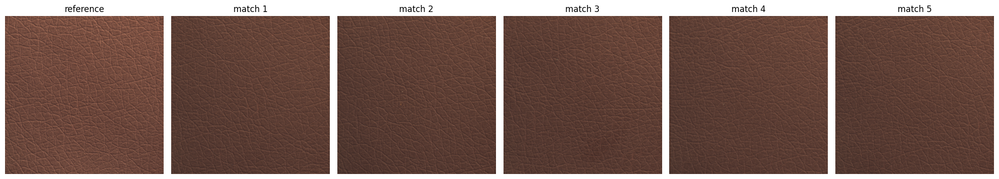

--------------------------------------------------------------------------------

--- LEATHER CATEGORY ---
reference image: 010.png
similar images:
  1. 179.png
  2. 193.png
  3. 199.png
  4. 190.png
  5. 109.png


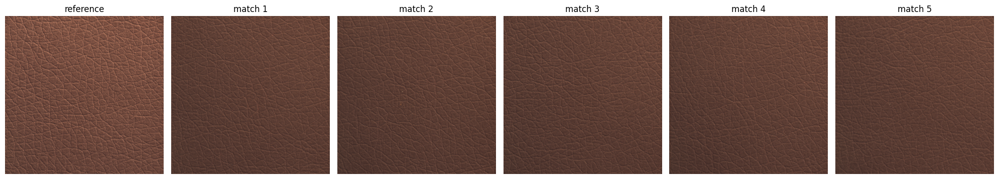

--------------------------------------------------------------------------------

--- LEATHER CATEGORY ---
reference image: 024.png
similar images:
  1. 179.png
  2. 199.png
  3. 193.png
  4. 212.png
  5. 165.png


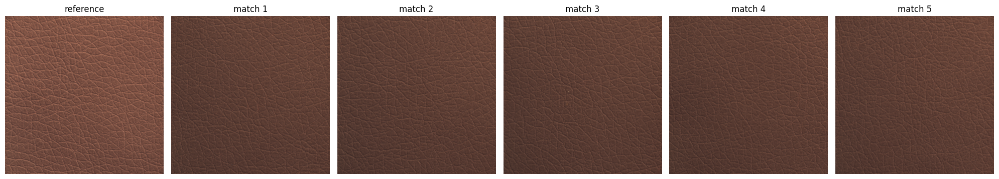

--------------------------------------------------------------------------------

--- LEATHER CATEGORY ---
reference image: 016.png
similar images:
  1. 199.png
  2. 193.png
  3. 179.png
  4. 195.png
  5. 166.png


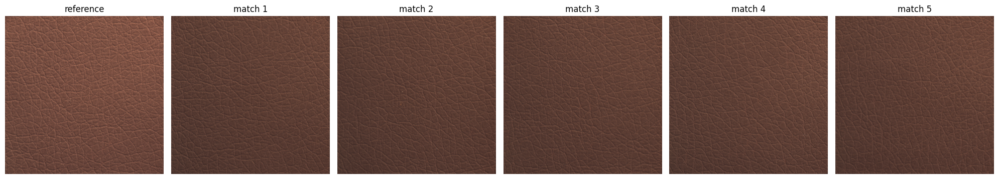

--------------------------------------------------------------------------------

--- LEATHER CATEGORY ---
reference image: 028.png
similar images:
  1. 199.png
  2. 179.png
  3. 195.png
  4. 193.png
  5. 109.png


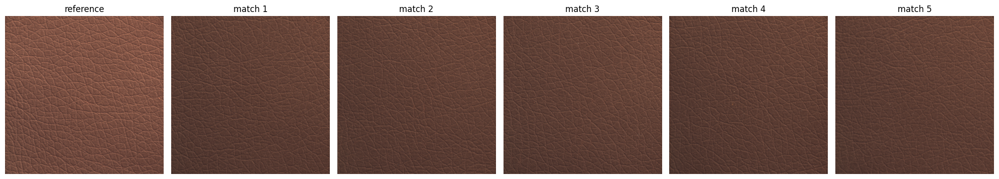

--------------------------------------------------------------------------------

starting processing for: grid
collected 264 training samples for grid
selected 5 test images for analysis


--- GRID CATEGORY ---
reference image: 006.png
similar images:
  1. 058.png
  2. 013.png
  3. 057.png
  4. 134.png
  5. 135.png


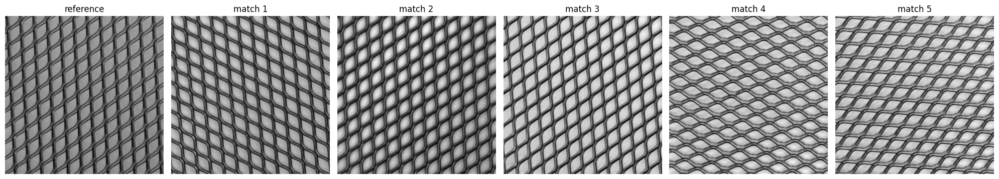

--------------------------------------------------------------------------------

--- GRID CATEGORY ---
reference image: 014.png
similar images:
  1. 080.png
  2. 180.png
  3. 120.png
  4. 109.png
  5. 134.png


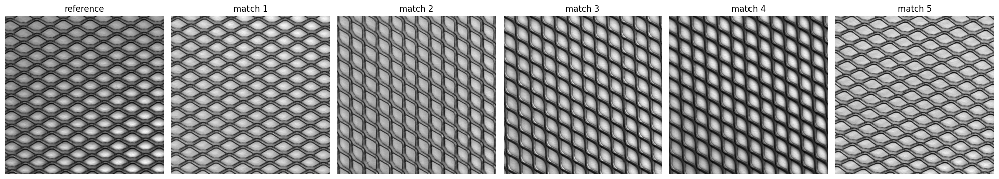

--------------------------------------------------------------------------------

--- GRID CATEGORY ---
reference image: 002.png
similar images:
  1. 067.png
  2. 025.png
  3. 134.png
  4. 180.png
  5. 079.png


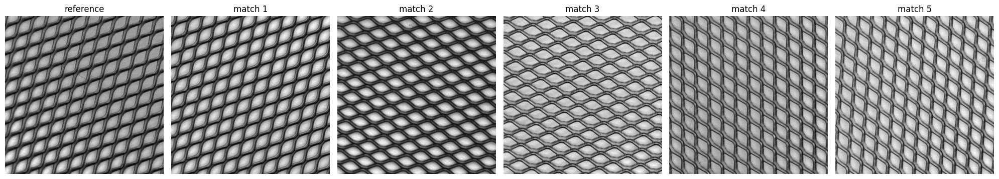

--------------------------------------------------------------------------------

--- GRID CATEGORY ---
reference image: 009.png
similar images:
  1. 009.png
  2. 184.png
  3. 180.png
  4. 104.png
  5. 080.png


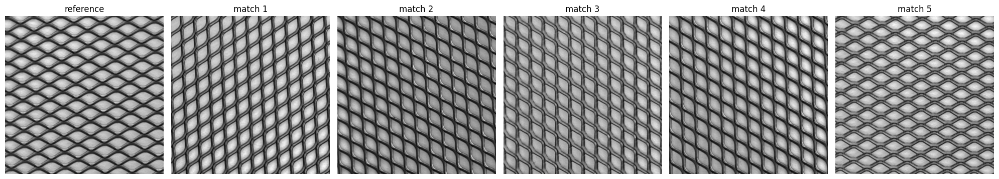

--------------------------------------------------------------------------------

--- GRID CATEGORY ---
reference image: 018.png
similar images:
  1. 253.png
  2. 134.png
  3. 119.png
  4. 133.png
  5. 180.png


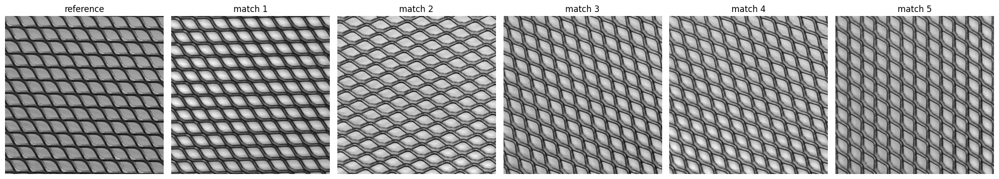

--------------------------------------------------------------------------------

starting processing for: tile
collected 230 training samples for tile
selected 5 test images for analysis


--- TILE CATEGORY ---
reference image: 005.png
similar images:
  1. 133.png
  2. 137.png
  3. 163.png
  4. 056.png
  5. 007.png


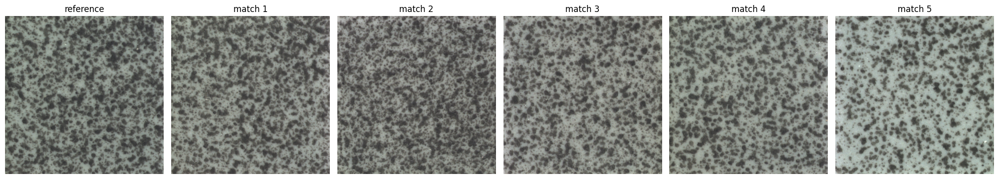

--------------------------------------------------------------------------------

--- TILE CATEGORY ---
reference image: 002.png
similar images:
  1. 170.png
  2. 015.png
  3. 078.png
  4. 136.png
  5. 048.png


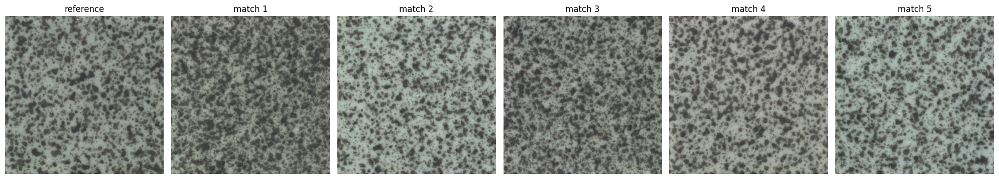

--------------------------------------------------------------------------------

--- TILE CATEGORY ---
reference image: 009.png
similar images:
  1. 015.png
  2. 137.png
  3. 136.png
  4. 163.png
  5. 115.png


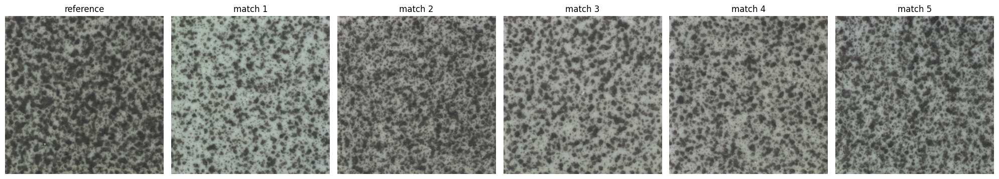

--------------------------------------------------------------------------------

--- TILE CATEGORY ---
reference image: 011.png
similar images:
  1. 149.png
  2. 017.png
  3. 136.png
  4. 137.png
  5. 045.png


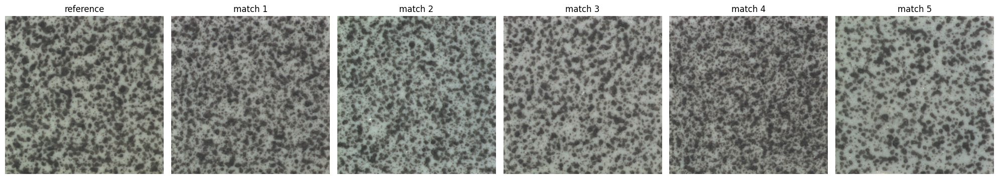

--------------------------------------------------------------------------------

--- TILE CATEGORY ---
reference image: 013.png
similar images:
  1. 015.png
  2. 115.png
  3. 170.png
  4. 078.png
  5. 137.png


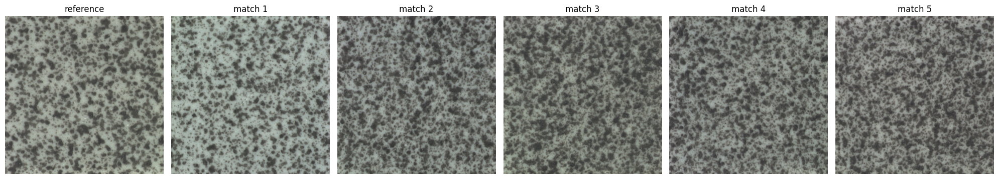

--------------------------------------------------------------------------------


In [34]:
# process each category
for cat in selected_categories:
    print(f"\nstarting processing for: {cat}")
    train_path = os.path.join(dataset_dir, cat, "train", "good")
    test_path = os.path.join(dataset_dir, cat, "test", "good")
    
    if not os.path.isdir(train_path) or not os.path.isdir(test_path):
        print(f"missing dirs for {cat}, skipping...\n")
        continue
    
    train_feats, train_imgs = get_features(train_path)
    print(f"collected {len(train_imgs)} training samples for {cat}")
    
    all_tests = [os.path.join(test_path, f) for f in os.listdir(test_path) if f.lower().endswith(".png")]
    random.shuffle(all_tests)
    selected_tests = all_tests[:5]
    print(f"selected {len(selected_tests)} test images for analysis\n")
    
    sims = similar_imgs(selected_tests, train_feats, train_imgs)
    show_results(sims, cat)